## CIFAR10 Spectra

In this notebook, we are exclusively interested in the power law spectral properties of the Krotov and Hopfield model in case of the CIFAR10 data set

In [1]:
%load_ext autoreload
%autoreload 2

import torch
from torch import nn
from torchvision.transforms import ToTensor
from torch.utils.data import DataLoader
from pathlib import Path
from context import LocalLearning
from tqdm.notebook import tqdm
import numpy as np
from matplotlib import pyplot as plt
import os
import copy
from scipy import stats

plt.style.use(['seaborn-paper', "./PRLDoubleCol.mplstyle"])

In [2]:
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

## Train the model

In [4]:
# train Flipswitch
TRAIN = False

# hyper-parameter
BATCH_SIZE = 1000
NUMBER_OF_EPOCHS = 1000

model_path = Path("../data/models/CIFAR10_PowerLaw")
figure_path = Path("../data/figures/CIFAR10_PowerLaw")

model_ps = {
    "in_size": 3*32**2,
    "hidden_size": 2000,
    "n": 4.5,
    "p": 3.0,
    "tau_l": 1.0 / 0.02, # 1 / learning_rate
    "k": 2,
    "Delta": 0.4,
    "R": 1.0,
}

In [4]:
if TRAIN:
    
    # initialize the krotov hopfield model
    khlayer = LocalLearning.FKHL3(model_ps, sigma=1.0)
    khlayer.to(device=device)
    
    training_data = LocalLearning.LpUnitCIFAR10(
        root="../data/CIFAR10",
        train=True,
        transform=ToTensor(),
        p=model_ps["p"],
    )
    
    dataloader_train = LocalLearning.DeviceDataLoader(
        training_data,
        device=device,
        batch_size=BATCH_SIZE,
        num_workers=4,
        shuffle=True,
    )
    
    # training
    lr = 1.0 / model_ps["tau_l"]
    def learning_rate(epoch: int) -> float:
        return (1.0 - epoch / NUMBER_OF_EPOCHS) * lr

    LocalLearning.train_unsupervised(
        dataloader_train,
        khlayer,
        device,
        model_path,
        no_epochs=NUMBER_OF_EPOCHS,
        checkpt_period=NUMBER_OF_EPOCHS,
        learning_rate=learning_rate,
    )

    torch.save(
        {
            "model_state_dict": khlayer.state_dict(),
            "model_parameters": khlayer.param_dict(),
            "device_type": device.type,
        },
        model_path / Path("kh_cifar10.pty"),
    )

## Spectral Analysis

1. load the model from path

In [10]:
# get a list of all files in model_path directory
#filenames = os.listdir(model_path)
filepath = model_path / Path("kh_cifar10.pty")

if os.path.isfile(filepath):
    storage_obj = torch.load(filepath)

with torch.no_grad():
    model_ps = storage_obj["model_parameters"]
    khlayer = LocalLearning.FKHL3(model_ps)
    khlayer.load_state_dict(storage_obj["model_state_dict"])
    khlayer.to(device)
    khlayer.eval()

In [52]:
test_data = LocalLearning.LpUnitCIFAR10(
    root="../data/CIFAR10",
    train=False,
    transform=ToTensor(),
    p=khlayer.pSet["p"],
)

dataloader_test = LocalLearning.DeviceDataLoader(
    test_data,
    device=device,
    batch_size=BATCH_SIZE,
    num_workers=4,
    shuffle=False,
)

gauss_noise_params = {"mu": 0.0, "sigma": 1.0, "img_width_px": 32, "img_height_px": 32, "img_ch_num": 3} # standard normal Wiener process
gauss_data = LocalLearning.GaussianData(gauss_noise_params, train=False)

dataloader_gauss = DataLoader(
    gauss_data,
    batch_size=BATCH_SIZE,
    num_workers=4,
    shuffle=False,
)

Files already downloaded and verified


In [45]:
def well_balanced_alpha_gradient(index: int, series_length: int) -> float:
    # well balanced alpha range for line plots: 30%-100%
    return 0.3 + 0.7*index / series_length

fig, axs = plt.subplots(1, 2)
for i, (cifar_spectrum, gauss_spectrum) in enumerate(zip(spectra_cifar, spectra_gauss)):
    cs = cifar_spectrum.copy()
    gs = gauss_spectrum.copy()
    
    # renormalize the x range
    n = np.arange(1, len(gs) + 1)
    n = np.divide(n, float(n[-1]))
    
    # renormalize the spectral data
    cs /= cs[0]
    gs /= gs[0]
    
    alpha = well_balanced_alpha_gradient(i, len(spectra_gauss))
    axs[0].loglog(n, cs, "-", color='#1b7837', alpha=alpha)
    axs[1].loglog(n, gs, "-", color='#762a83', alpha=alpha)

#ax.loglog(n, l_n_trained_gauss)
#fig.title(r"")
fig.text(0.5, 0.04, r"Dimension $n / N$", ha='center')
axs[0].set_ylabel(r"Variance fraction $\lambda_{n} / \lambda_{0}$")
axs[0].set_title(r"CIFAR10")
axs[1].set_title(r"$\xi(t)$")
fig.savefig(figure_path / Path("UnprunedSpectra_VaryHiddenSize.pdf"))
plt.show()

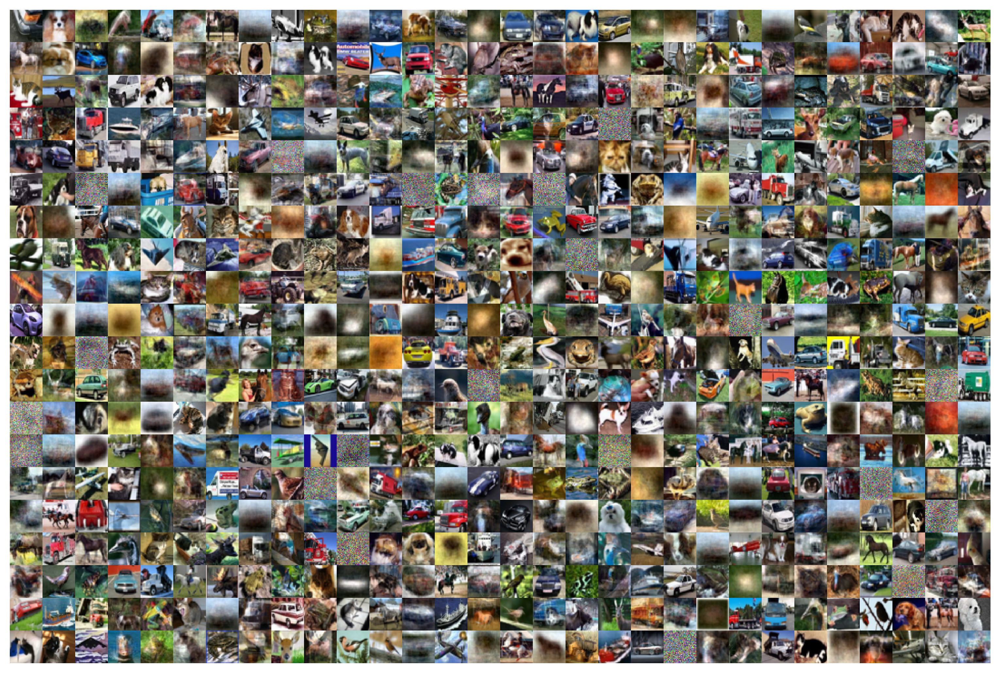

In [46]:
# Show a subset of weights
fig, ax = display_model_weights(khlayer)
plt.show()

In [47]:
# save the weight matrix of the model outside of the model
W = khlayer.W.clone()
h_sizes = [10, 50, 100, 500, 1000, 1500, 2000]
spectra_cifar = []
spectra_gauss = []
for h_size in h_sizes:
    
    model_ps["hidden_size"] = h_size
    khlayer_r = LocalLearning.FKHL3(model_ps, sigma=1.0)
    khlayer_r.W = nn.Parameter(W[:, :h_size])
    khlayer.to(device)
    khlayer.eval()
    
    with torch.no_grad():
        l_n_trained_cifar = l_n_trained_cifar = LocalLearning.cov_spectrum(dataloader_test, khlayer_r, device)
        l_n_trained_cifar = l_n_trained_cifar.detach().cpu().clone().numpy()
        spectra_cifar.append(l_n_trained_cifar)
        
        l_n_trained_gauss = LocalLearning.cov_spectrum(dataloader_gauss, khlayer_r, device)
        l_n_trained_gauss = l_n_trained_gauss.detach().cpu().clone().numpy()
        spectra_gauss.append(l_n_trained_gauss)

Calculating covariance spectrum: 100%|██████████| 10/10 [00:00<00:00, 14.41batch/s]


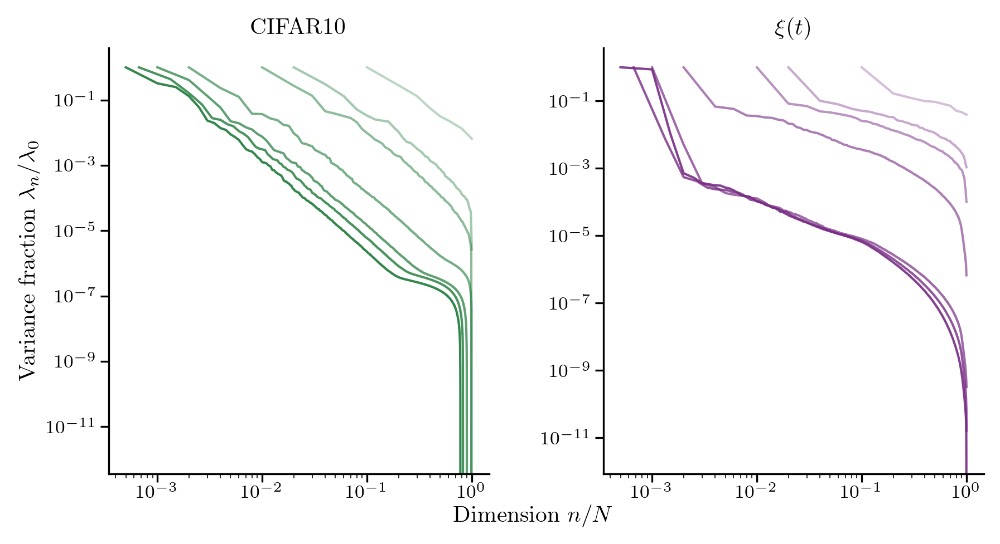

In [48]:
def well_balanced_alpha_gradient(index: int, series_length: int) -> float:
    # well balanced alpha range for line plots: 30%-100%
    return 0.3 + 0.7*index / series_length

fig, axs = plt.subplots(1, 2)
for i, (cifar_spectrum, gauss_spectrum) in enumerate(zip(spectra_cifar, spectra_gauss)):
    cs = cifar_spectrum.copy()
    gs = gauss_spectrum.copy()
    
    # renormalize the x range
    n = np.arange(1, len(gs) + 1)
    n = np.divide(n, float(n[-1]))
    
    # renormalize the spectral data
    cs /= cs[0]
    gs /= gs[0]
    
    alpha = well_balanced_alpha_gradient(i, len(spectra_gauss))
    axs[0].loglog(n, cs, "-", color='#1b7837', alpha=alpha)
    axs[1].loglog(n, gs, "-", color='#762a83', alpha=alpha)

#ax.loglog(n, l_n_trained_gauss)
#fig.title(r"")
fig.text(0.5, 0.04, r"Dimension $n / N$", ha='center')
axs[0].set_ylabel(r"Variance fraction $\lambda_{n} / \lambda_{0}$")
axs[0].set_title(r"CIFAR10")
axs[1].set_title(r"$\xi(t)$")
fig.savefig(figure_path / Path("UnprunedSpectra_VaryHiddenSize.pdf"))
plt.show()

## Why the step?

Varying the dimension of the weights matrix, we see, that the eventual decrease is a boundary effect.
The same applies for the initial curvature in the CIFAR10 spectrum.
In the central region, the shape of the linear decay persists.

Taking a look at the Gaussian Noise spectrum, one notices the initial step.
The question arises why that step is occuring?

Scaling the input or the weight matrix shifts the spectrum overall along the variance.
Thus, the particular choice of signaling strength has nothing to do with it and renormalization of the signal won't fix it.

However, taking a look at the weights we see that most of them have row-wise (in the hidden units) converged to images.
Thus, each hidden units encodes prototype like features.
Some weights though have not converged yet and the corresponding images look just noisy.
Thus, it is to be expected that the majority of the variance is contributed by these high noise images.
In consequence, the first principle component might be encoding the direction of the noisy images only, as they contain the highest contribution with regard to the total variance of the weights and, thus, the signal.

### Eigenvectors of the PCA

In general, the model predicts $\eta$ from $\xi$ by $$\eta = W\, \xi$$.
In the following, we assume $\mathbb{E}[\xi] = \mathbb{E}[\eta] = 0$. 
Otherwise, the data can be shiftet accordingly so this holds true. 
Then,
$$C_{\eta} = \mathbb{E}[\eta^{T} \eta] = W \mathbb{\eta^{T} \eta} W^{T} = W C_{\xi} W^{T}$$.
Since $\xi$ is gaussian white noise, $$C_{\xi} = \sigma^{2} \mathbb{1}$$ with $\sigma$ denoting the standard deviation of the fluctuations in $\xi$.

With PCA, we find the eigenvectors $Q$ that diagonalize $Q\, C_{\eta}$ $$ Q\, \text{diag}(\Lambda)\, Q^{\dagger} = W C_{\xi} W^{T} = \sigma^{2} W\, W^{T}$$
such that 
$$\text{diag}(\Lambda) = Q^{\dagger}\, W\, W^{T} Q$$, thus

$Q^{\dagger}$ projects the weight matrix $W$ to the PCA space.
Thus, by selecting singular eigenvectors, we can actually build a projection matrix that eliminates those contributions that correspond to the high variance spectral components.
However, unfortunately, this does strictly only work for $W\, W^{T}$.
**Maybe, we can project W by using its inverse? -> check for prove**

### Important insight
If the signal is gaussian noise, $C_{\eta} = W\, W^{T}$. Consequently, high variance contributions in $C_{\eta}$ directly correspond to high variance contributions in $W$. 

## Pruning

To proove that the noisy images are responsible for the step in the PCA spectrum, we are going to eliminate them from the weight matrix.
Biologically, this would translate to ablate the respective encoding hidden neurons.

### Display entire weightset

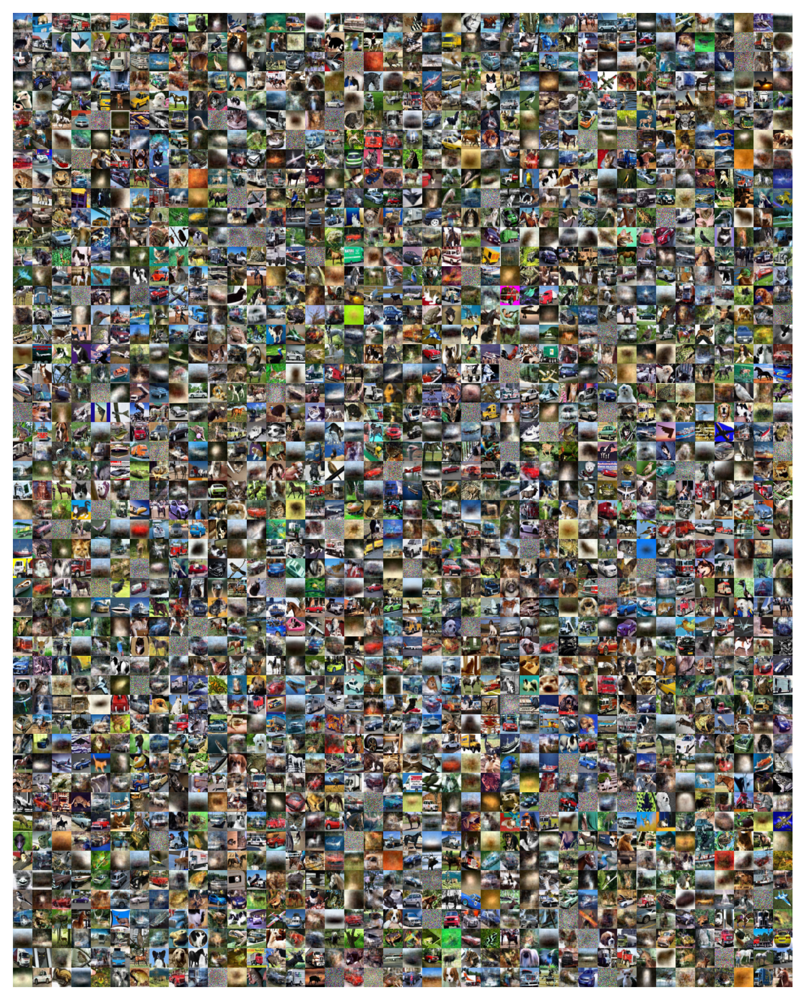

In [11]:
fig, ax = display_model_weights(khlayer, Kx=40, Ky=50, shuffle=False)
plt.show()

We can investigate the images one by one to manually identify all random images.

In [16]:
# copy weight set
W_np = khlayer.W.detach().cpu().clone().numpy()

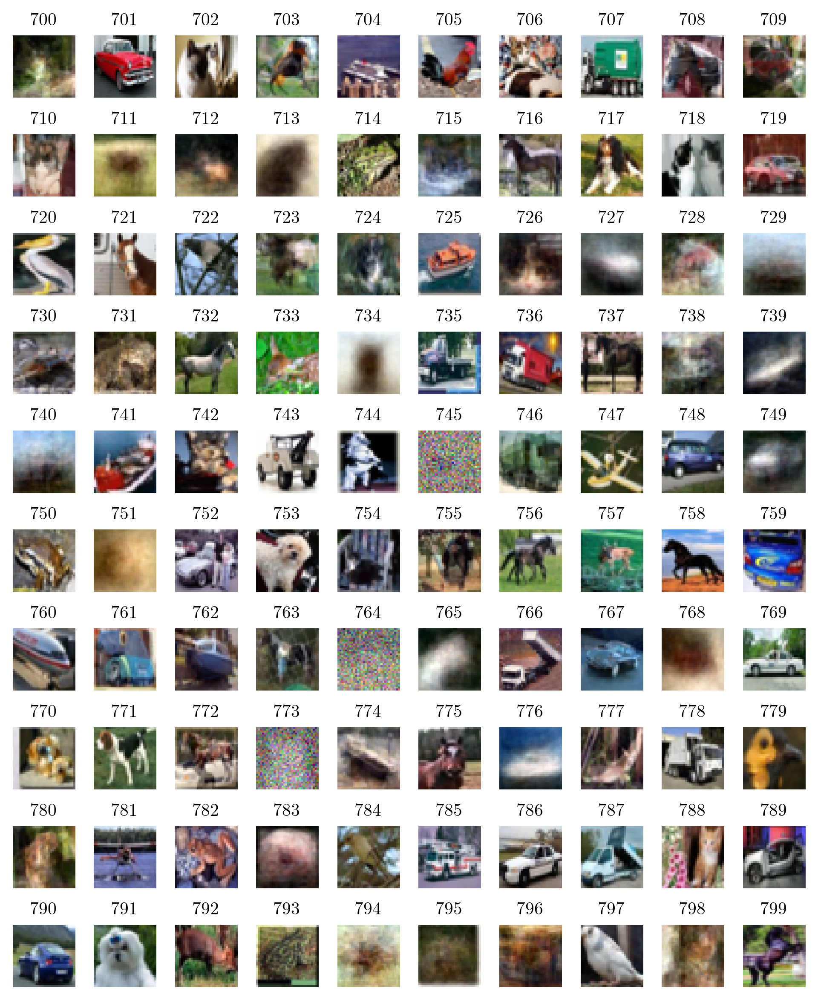

In [13]:
# Display the next 100 images starting with index 700 to manually identify the noisy ones
# visualize corresponding indices to ease identification
offset = 700
fig, axs = plt.subplots(10, 10, figsize=(8., 10.))
for i in range(10):
    for j in range(10):
        axs[i, j].imshow(MinMaxNorm(W_np.T[offset + i*10 + j].reshape(32, 32, 3)), cmap="bwr")
        axs[i, j].axis("off")
        axs[i, j].set_title(str(offset + i*10 + j))
plt.show()

In [14]:
# list of all noisy images
noisy_img_idx = [77, 97, 117, 204, 210, 216, 254, \
                 269, 271, 283, 371, 384, 433, 451, \
                 452, 461, 462, 495, 543, 563, 566, \
                 639, 670, 745, 764, 773, 800, 823, \
                 830, 867, 887, 905, 919, 939, 954, \
                 966, 1004, 1042, 1056, 1106, 1126, \
                 1140, 1152, 1164, 1173, 1190, 1249, \
                 1263, 1288, 1366, 1425, 1548, 1618, \
                 1627, 1629, 1631, 1687, 1697, 1781, \
                 1838, 1861, 1868, 1909, 1956, 1970, \
                 1976, 1978, 1990, ]

# create mask for further analysis
noisy_img_mask = np.zeros((2000, ), dtype=bool)
noisy_img_mask[noisy_img_idx] = True

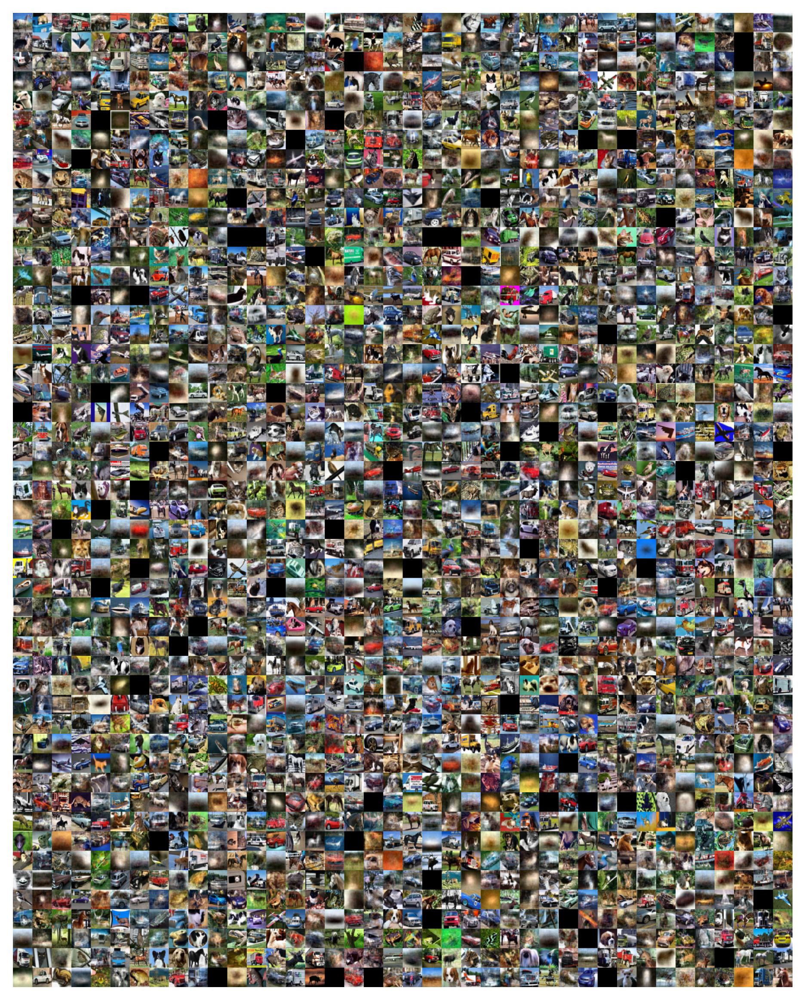

In [15]:
# create a pruned model base on the noisy img mask
with torch.no_grad():
    khlayer_pruned = copy.deepcopy(khlayer)
    khlayer_pruned.W.T[noisy_img_mask] = 0.0
    khlayer.to(device)
    khlayer.eval()

fig, ax = display_model_weights(khlayer_pruned, Kx=40, Ky=50, shuffle=False)
plt.show()

Indeed, we do not see any noisy images anymore, instead the noisy images have been filled with black tiles.
However, those tiles do not contribute to the total variance, as they are homogeneously $0.0$ which means they only contribute with variance $0.0$.

Let us take a look at its spectrum.

In [16]:
# calculate spectrum of the pruned model
with torch.no_grad():
    l_n_pruned_cifar = LocalLearning.cov_spectrum(dataloader_test, khlayer_pruned, device)
    l_n_pruned_cifar = l_n_pruned_cifar.detach().cpu().clone().numpy()
        
    l_n_pruned_gauss = LocalLearning.cov_spectrum(dataloader_gauss, khlayer_pruned, device)
    l_n_pruned_gauss = l_n_pruned_gauss.detach().cpu().clone().numpy()

Calculating covariance spectrum: 100%|██████████████████████████████████████████████| 10/10 [00:00<00:00, 31.13batch/s]


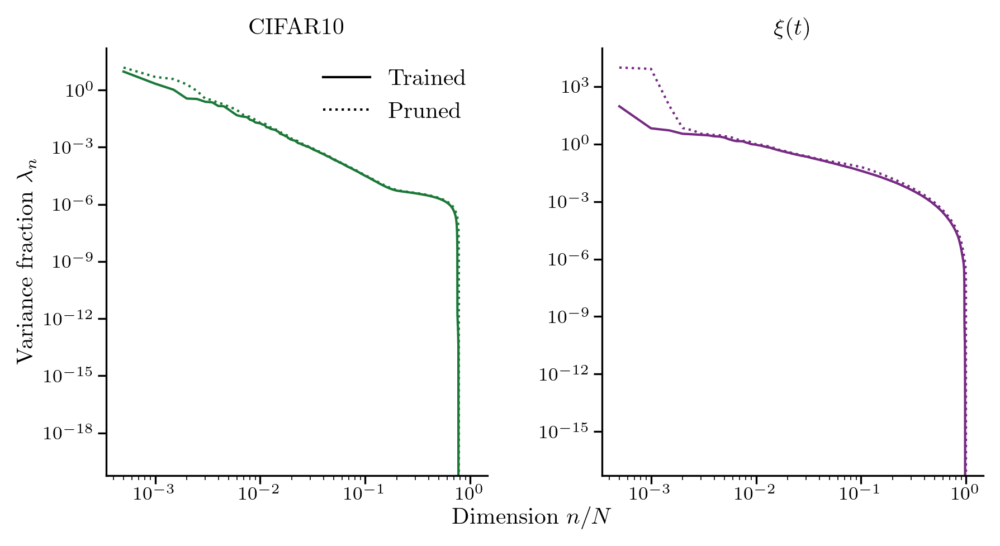

In [17]:
from matplotlib.lines import Line2D

fig, axs = plt.subplots(1, 2)

noD = len(l_n_pruned_cifar) + 1
n = np.arange(1, noD) / noD

axs[0].loglog(n, l_n_pruned_cifar, "-", color='#1b7837')
axs[0].loglog(n, l_n_trained_cifar, ":", color='#1b7837')
axs[1].loglog(n, l_n_pruned_gauss, "-", color='#762a83')
axs[1].loglog(n, l_n_trained_gauss, ":", color='#762a83')

#fig.title(r"")
fig.text(0.5, 0.04, r"Dimension $n / N$", ha='center')
axs[0].set_ylabel(r"Variance fraction $\lambda_{n}$")
axs[0].set_title(r"CIFAR10")
axs[1].set_title(r"$\xi(t)$")

lines = [
    Line2D([0], [0], color="#000000", linestyle="-"),
    Line2D([0], [0], color="#000000", linestyle=":"),
]
axs[0].legend(lines, ["Trained", "Pruned"])

plt.show()

Indeed, we see that, following our intuition, we could reduce the initial step in the gaussian signal spectrum significantly.
Now, there is only the first component which deviates a bit, which the bordereffect could be made accountable for.

In [18]:
# run the analysis
W_pruned = khlayer_pruned.W.clone()
h_sizes = [10, 50, 100, 500, 1000, 1500, 2000]
pruned_spectra_cifar = []
pruned_spectra_gauss = []
for h_size in h_sizes:
    
    model_ps["hidden_size"] = h_size
    khlayer_sub = LocalLearning.FKHL3(model_ps, sigma=1.0)
    khlayer_sub.W = nn.Parameter(W_pruned[:, :h_size])
    khlayer_sub.to(device)
    khlayer_sub.eval()
    
    with torch.no_grad():
        l_n_pruned_cifar = LocalLearning.cov_spectrum(dataloader_test, khlayer_sub, device)
        l_n_pruned_cifar = l_n_pruned_cifar.detach().cpu().clone().numpy()
        pruned_spectra_cifar.append(l_n_pruned_cifar)
        
        l_n_pruned_gauss = LocalLearning.cov_spectrum(dataloader_gauss, khlayer_sub, device)
        l_n_pruned_gauss = l_n_pruned_gauss.detach().cpu().clone().numpy()
        pruned_spectra_gauss.append(l_n_pruned_gauss)
        
    del khlayer_sub

Calculating covariance spectrum: 100%|██████████████████████████████████████████████| 10/10 [00:00<00:00, 29.56batch/s]


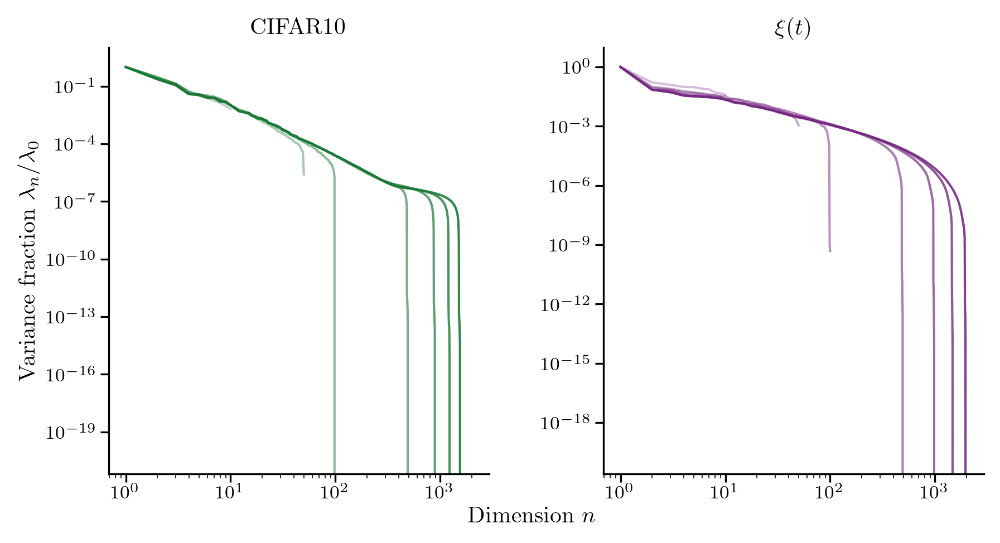

In [19]:
fig, axs = plt.subplots(1, 2)
for i, (cifar_spectrum, gauss_spectrum) in enumerate(zip(pruned_spectra_cifar, pruned_spectra_gauss)):
    cs = cifar_spectrum.copy()
    gs = gauss_spectrum.copy()
    
    # renormalize the x range
    n = np.arange(1, len(gs) + 1)
    #n = np.divide(n, float(n[-1]))
    
    # renormalize the spectral data
    cs /= cs[0]
    gs /= gs[0]
    
    alpha = well_balanced_alpha_gradient(i, len(spectra_gauss))
    axs[0].loglog(n, cs, "-", color='#1b7837', alpha=alpha)
    axs[1].loglog(n, gs, "-", color='#762a83', alpha=alpha)

#ax.loglog(n, l_n_trained_gauss)
#fig.title(r"")
fig.text(0.5, 0.04, r"Dimension $n$", ha='center')
axs[0].set_ylabel(r"Variance fraction $\lambda_{n} / \lambda_{0}$")
axs[0].set_title(r"CIFAR10")
axs[1].set_title(r"$\xi(t)$")
plt.show()

As it is apparent, the spectrum of the pruned model exhibits a close to perfect power law.
In the case of the gaussian noise, we successfully decelerated the initial decay.
However, we see that there is still a initial accelerated which could also be due to a boundary effect.

That raises the question whether a manual selection of the images was the right way to proceed or whether we can find a rather quantitative criterion to do the selection for us.

## Pruning with cutoff

The box plot below shows a clear seperation of variances between the two subpopulations: coherent images and random ones.

Based on the box plots, a fair cutoff seems to be around a variance of $$\textrm{var} \simeq 0.0015$$. 
This approximately coincides with the value that lies between the 3rd quantile of the coherent distribution and the first quantile of the noisy one $$\sigma_{\textrm{thresh}} := Q_{3}^{\textrm{coh}} + \frac{Q_{1}^{\textrm{noisy}} - Q_{3}^{\textrm{coh}}}{2}$$.

(array([0.        , 0.01576439, 0.        , 0.00788219, 0.01576415,
        0.02364658, 0.02364658, 0.03152877, 0.04729316, 0.06305754,
        0.07093974, 0.05517535, 0.07882075, 0.06305754, 0.10246851,
        0.08670412, 0.06305754, 0.08670412, 0.13399628, 0.1182329 ,
        0.14976167, 0.17340825, 0.30740323, 0.29952334, 0.47293159,
        0.64633983, 0.8985633 , 1.10350704, 1.142918  , 1.53702766,
        1.40301989, 1.37938379, 1.24538651, 0.90645221, 0.69362781,
        0.59904668, 0.55175352, 0.27587676, 0.14187948, 0.07093921,
        0.06305754, 0.03941097, 0.10246851, 0.14976055, 0.12611509,
        0.06305754, 0.01576439, 0.01576427, 0.00788219, 0.        ]),
 array([-9.       , -8.936183 , -8.872366 , -8.808549 , -8.744732 ,
        -8.680914 , -8.617097 , -8.55328  , -8.489463 , -8.425646 ,
        -8.361829 , -8.298012 , -8.234195 , -8.170377 , -8.10656  ,
        -8.042743 , -7.9789257, -7.9151087, -7.8512917, -7.787474 ,
        -7.723657 , -7.65984  , -7.596023 , -7

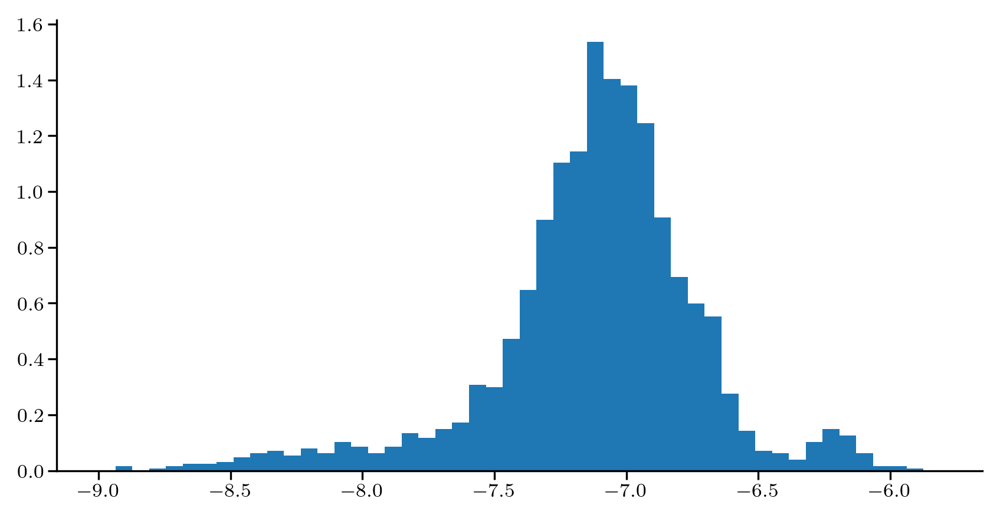

In [41]:
vars = np.var(W_np.T, axis=-1)
log_vars = np.log(vars)
counts, bins = np.histogram(log_vars, bins=50, range=(-9, np.log(3e-3)), density=True)
plt.hist(bins[:-1], bins, weights=counts)

In [43]:
np.log(0.0015)

-6.502290170873972

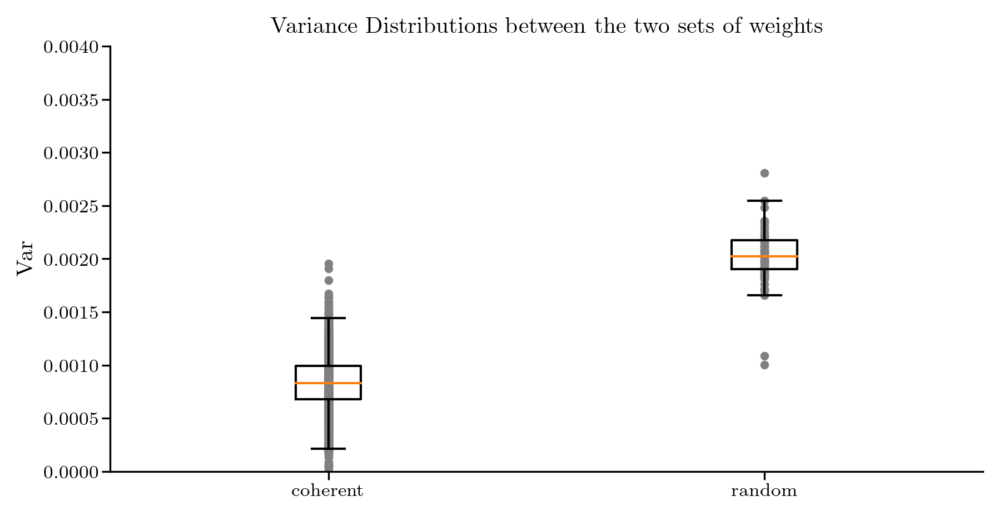

In [20]:
noisy_vars = np.var(W_np.T[noisy_img_mask], axis=-1)
coherent_vars = np.var(W_np.T[np.logical_not(noisy_img_mask)], axis=-1)

data = [coherent_vars, noisy_vars]
fig, ax = plt.subplots()
ax.boxplot(data, labels=["coherent", "random"], showfliers=False, zorder=1)
ax.scatter(np.ones((len(coherent_vars), )), coherent_vars, zorder=0, color="grey")
ax.scatter(2*np.ones((len(noisy_vars), )), noisy_vars, zorder=0, color="grey")
ax.set_ylim([0.0, 4e-3])
ax.set_title("Variance Distributions between the two sets of weights")
ax.set_ylabel("Var")
fig.savefig(figure_path / Path("VarianceDistributions_weights.pdf"))
plt.show()

In [21]:
q3_coh = np.quantile(coherent_vars, q=0.75)
q1_noisy = np.quantile(noisy_vars, q=0.25)
sigma_t = q3_coh + (q1_noisy - q3_coh) / 2.0
print(f"Calculated threshold: {sigma_t:.4f}")

Calculated threshold: 0.0014


In [22]:
print(f"Number manually selected images: {noisy_img_mask.sum()}")
noise_mask = np.var(W_np, axis=0) > sigma_t
print(f"Number of selected images: {noise_mask.sum()}")

Number manually selected images: 68
Number of selected images: 88


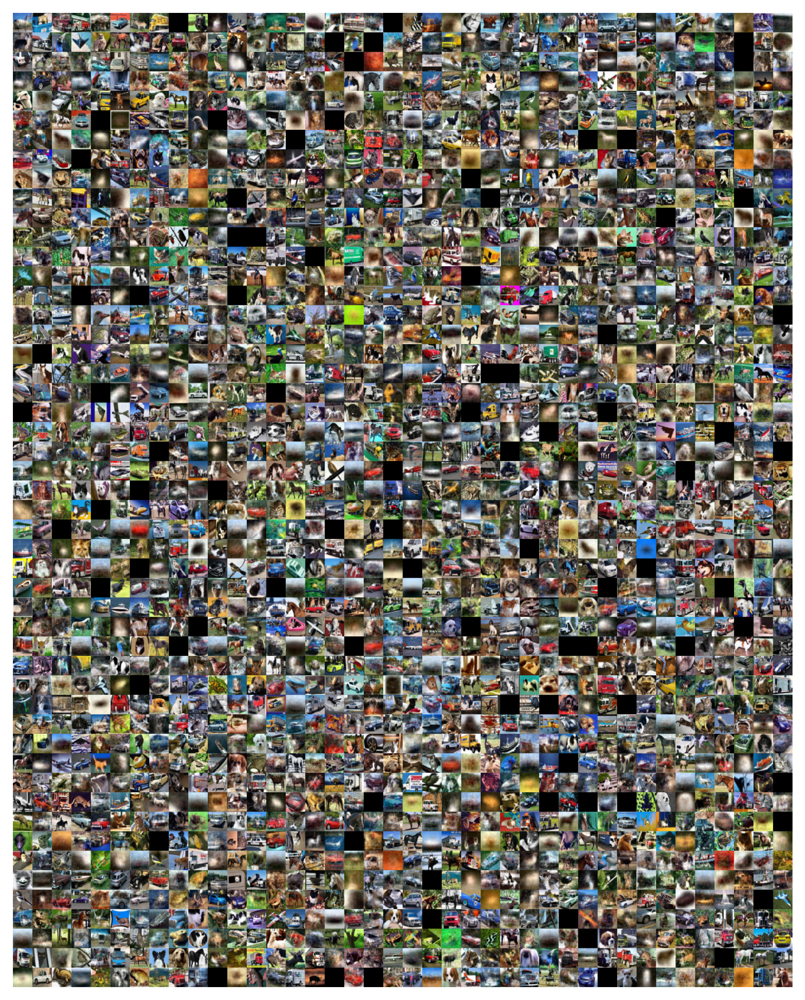

In [23]:
with torch.no_grad():
    khlayer_pruned_thr = copy.deepcopy(khlayer)
    khlayer_pruned_thr.W.T[noise_mask] = 0.0
    khlayer_pruned_thr.to(device)
    khlayer_pruned_thr.eval()
    
fig, ax = display_model_weights(khlayer_pruned_thr, Kx=40, Ky=50, shuffle=False)
plt.show()

In [24]:
with torch.no_grad():
    l_n_pruned_thr_cifar = LocalLearning.cov_spectrum(dataloader_test, khlayer_pruned_thr, device)
    l_n_pruned_thr_cifar = l_n_pruned_thr_cifar.detach().cpu().clone().numpy()
        
    l_n_pruned_thr_gauss = LocalLearning.cov_spectrum(dataloader_gauss, khlayer_pruned_thr, device)
    l_n_pruned_thr_gauss = l_n_pruned_thr_gauss.detach().cpu().clone().numpy()

Calculating covariance spectrum: 100%|██████████████████████████████████████████████| 10/10 [00:00<00:00, 31.04batch/s]


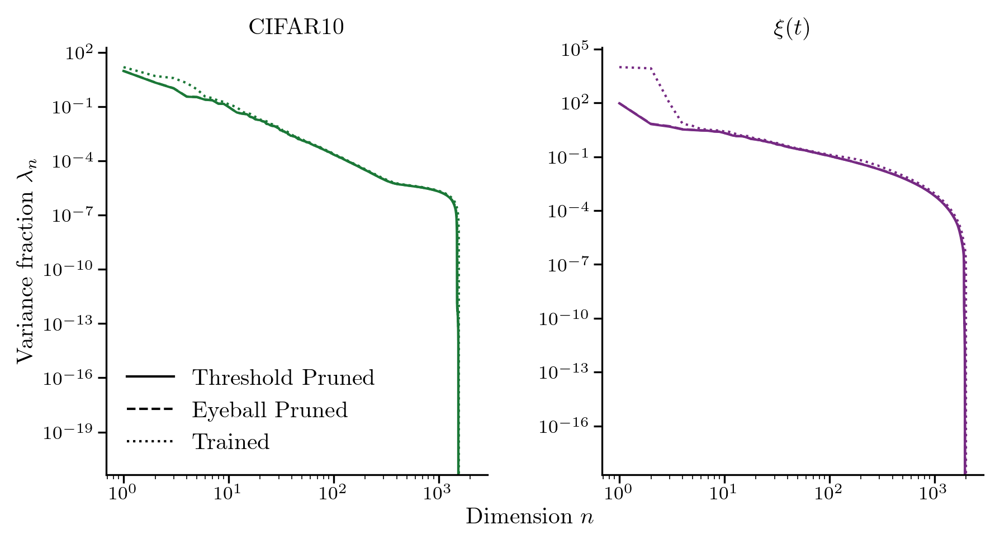

In [25]:
from matplotlib.lines import Line2D

fig, axs = plt.subplots(1, 2)

noD = len(l_n_pruned_cifar) + 1
n = np.arange(1, noD)

axs[0].loglog(n, l_n_pruned_thr_cifar, "-", color='#1b7837')
axs[0].loglog(n, l_n_pruned_cifar, "--", color='#1b7837')
axs[0].loglog(n, l_n_trained_cifar, ":", color='#1b7837')

axs[1].loglog(n, l_n_pruned_thr_gauss, "-", color='#762a83')
axs[1].loglog(n, l_n_pruned_gauss, "--", color='#762a83')
axs[1].loglog(n, l_n_trained_gauss, ":", color='#762a83')

#fig.title(r"")
fig.text(0.5, 0.04, r"Dimension $n$", ha='center')
axs[0].set_ylabel(r"Variance fraction $\lambda_{n}$")
axs[0].set_title(r"CIFAR10")
axs[1].set_title(r"$\xi(t)$")

lines = [
    Line2D([0], [0], color="#000000", linestyle="-"),
    Line2D([0], [0], color="#000000", linestyle="--"),
    Line2D([0], [0], color="#000000", linestyle=":"),
]
axs[0].legend(lines, ["Threshold Pruned", "Eyeball Pruned", "Trained"])
fig.savefig(figure_path / Path("SpectralComparison_DifferentPruningMethods.pdf"))

plt.show()

Luckily, it seems as if the difference between manual and threshold based pruning it not evident in the actual spectral distribution.
Thus, we choose the latter for testing for the power law relation.

In [26]:
# run the analysis
W_pruned_thr = khlayer_pruned_thr.W.clone()
h_sizes = [2, 5, 10, 50, 100, 500, 1000, 1500, 2000]
thr_pruned_spectra_cifar = []
thr_pruned_spectra_gauss = []
for h_size in h_sizes:
    
    model_ps["hiddArgumenten_size"] = h_size
    khlayer_sub = LocalLearning.FKHL3(model_ps, sigma=1.0)
    khlayer_sub.W = nn.Parameter(W_pruned_thr[:, :h_size])
    khlayer_sub.to(device)
    khlayer_sub.eval()
    
    with torch.no_grad():
        l_n_pruned_thr_cifar = LocalLearning.cov_spectrum(dataloader_test, khlayer_sub, device)
        l_n_pruned_thr_cifar = l_n_pruned_thr_cifar.detach().cpu().clone().numpy()
        thr_pruned_spectra_cifar.append(l_n_pruned_thr_cifar)
        
        l_n_pruned_thr_gauss = LocalLearning.cov_spectrum(dataloader_gauss, khlayer_sub, device)
        l_n_pruned_thr_gauss = l_n_pruned_thr_gauss.detach().cpu().clone().numpy()
        thr_pruned_spectra_gauss.append(l_n_pruned_thr_gauss)
        
    del khlayer_sub

Calculating covariance spectrum: 100%|██████████████████████████████████████████████| 10/10 [00:00<00:00, 28.13batch/s]


In [1]:
# fit linear models to the power law part of the spectrum
min_win = 1
max_win = 500

selected_n = n.copy()[min_win: max_win]
selected_cifar_spectrum = thr_pruned_spectra_cifar[-1].copy()
selected_cifar_spectrum = (selected_cifar_spectrum / selected_cifar_spectrum[0])[min_win: max_win]
selected_gauss_spectrum = thr_pruned_spectra_gauss[-1].copy()
selected_gauss_spectrum = (selected_gauss_spectrum / selected_gauss_spectrum[0])[min_win: max_win]

slope_cifar, intercept_cifar, r_cifar, p_cifar, std_err_cifar = \
    stats.linregress(np.log(selected_n), np.log(selected_cifar_spectrum))

slope_gauss, intercept_gauss, r_gauss, p_gauss, std_err_gauss = \
    stats.linregress(np.log(selected_n), np.log(selected_gauss_spectrum))

print(f"CIFAR10: alpha = {slope_cifar:.2f} +- {std_err_cifar:.2f} | R = {r_cifar:.4f}, p = {p_cifar:.4f}")
print(f"xi(t): alpha = {slope_gauss:.2f} +- {std_err_gauss:.2f} | R = {r_gauss:.4f}, p = {p_gauss:.4f}")

NameError: name 'n' is not defined

In [28]:
def l_n(n: np.array, alpha, l_0) -> np.array:
    return np.exp(l_0 + alpha*np.log(n))

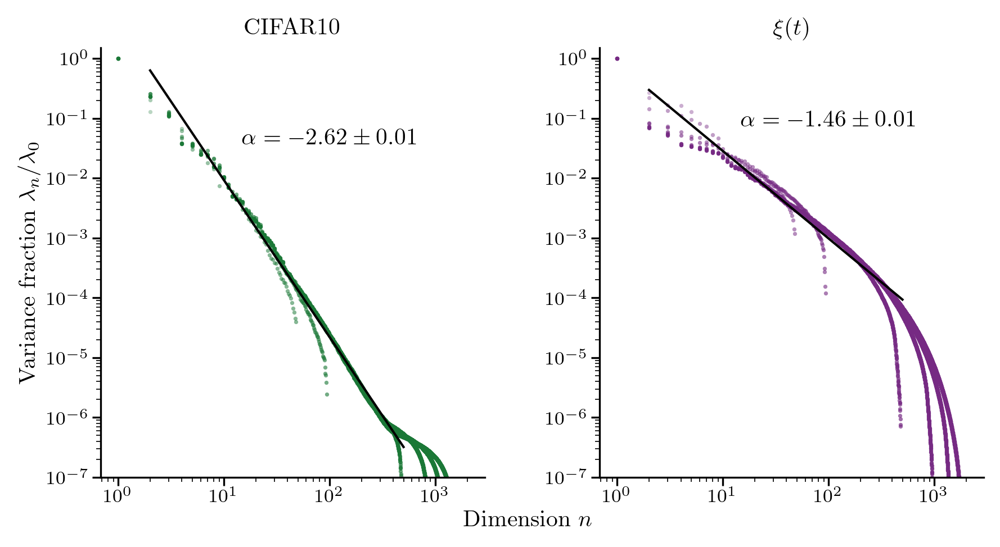

In [29]:
fig, axs = plt.subplots(1, 2)
for i, (cifar_spectrum, gauss_spectrum) in enumerate(zip(thr_pruned_spectra_cifar, thr_pruned_spectra_gauss)):
    cs = cifar_spectrum.copy()
    gs = gauss_spectrum.copy()
    
    # renormalize the x range
    n = np.arange(1, len(gs) + 1)
    #n = np.divide(n, float(n[-1]))
    
    # renormalize the spectral data
    cs /= cs[0]
    gs /= gs[0]
    
    alpha = well_balanced_alpha_gradient(i, len(thr_pruned_spectra_gauss))
    axs[0].loglog(n, cs, ".", color='#1b7837', alpha=alpha)
    axs[1].loglog(n, gs, ".", color='#762a83', alpha=alpha)

axs[0].loglog(selected_n, l_n(selected_n, slope_cifar, intercept_cifar), "-", color='#000000')
axs[1].loglog(selected_n, l_n(selected_n, slope_gauss, intercept_gauss), "-", color='#000000')
#ax.loglog(n, l_n_trained_gauss)
#fig.title(r"")
fig.text(0.5, 0.04, r"Dimension $n$", ha='center')
axs[0].set_ylabel(r"Variance fraction $\lambda_{n} / \lambda_{0}$")
axs[0].set_title(r"CIFAR10")
axs[1].set_title(r"$\xi(t)$")
axs[0].set_ylim([1e-7, 1.5])
axs[1].set_ylim([1e-7, 1.5])
axs[0].text(100., 5e-2, 
            r"$\alpha = " + f"{slope_cifar:.2f}" + r"\pm" f"{std_err_cifar:.2f}" + r"$", 
            horizontalalignment='center',
            verticalalignment='center',
            #transform=ax.transAxes,
           )
axs[1].text(100., 1e-1, 
            r"$\alpha = " + f"{slope_gauss:.2f}" + r"\pm" f"{std_err_gauss:.2f}" + r"$", 
            horizontalalignment='center',
            verticalalignment='center',
            #transform=ax.transAxes,
           )
fig.savefig(figure_path / Path("ValidatePowerLaw.pdf"))
plt.show()

In [30]:
print(f"Fractal dimension \n \t CIFAR10: d={(np.abs(slope_cifar) - 1.0)/2.0:.4f}" + 
    f"\n \t xi: d={(np.abs(slope_gauss) - 1.0)/2.0:.4f}")

Fractal dimension 
 	 CIFAR10: d=0.8124
 	 xi: d=0.2307


In [31]:
# save the pruned model
torch.save(
        {
            "model_state_dict": khlayer_pruned_thr.state_dict(),
            "model_parameters": khlayer_pruned_thr.param_dict(),
            "device_type": device.type,
        },
        model_path / Path("kh_cifar10_pruned_thr.pty"),
    )

## Analyse the fractal dimension in the CIFAR10 spectrum